<a href="https://colab.research.google.com/github/niharika896/EDA-Project/blob/main/MyEDAProject.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# US ACCIDENTS DATA EXPLORATORY ANALYSIS

Link to Kaggle Dataset -> [Link](https://www.kaggle.com/datasets/sobhanmoosavi/us-accidents)

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Downloading and importing data



In [ ]:
import kagglehub

path = kagglehub.dataset_download("sobhanmoosavi/us-accidents")
print("Files downloaded to:", path)


Using Colab cache for faster access to the 'us-accidents' dataset.
Files downloaded to: /kaggle/input/us-accidents


# Data Preparation and Cleaning

- loading file using pandas
- look at some info about the file
- fix any missing or incorrect values

### STEP 1:LOADING THE DATA

In [ ]:
import pandas as pd

# Count rows
total_rows = sum(1 for _ in open(f"{path}/US_Accidents_March23.csv")) - 1  # minus header
print(total_rows)


7728394


In [ ]:
import pandas as pd

file = f"{path}/US_Accidents_March23.csv"
chunksize = 200_000

parts = []

for chunk in pd.read_csv(file, chunksize=chunksize):
    # Convert to datetime safely inside chunk
    chunk['Start_Time'] = pd.to_datetime(chunk['Start_Time'], errors='coerce')

    # Filter for year 2022
    mask = chunk['Start_Time'].dt.year == 2022
    if mask.any():
        parts.append(chunk.loc[mask])

df = pd.concat(parts, ignore_index=True)


In [ ]:
df.shape

(1144496, 46)

In [ ]:
df[df['City']=="New York"]

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
676,A-512983,Source2,3,2022-09-08 09:05:59,2022-09-08 09:34:38,40.797428,-73.922112,NaN,NaN,0.000,...,False,False,False,False,False,False,Day,Day,Day,Day
867,A-513198,Source2,3,2022-09-06 21:04:13,2022-09-07 01:27:49,40.847946,-73.942787,NaN,NaN,0.000,...,False,False,False,False,False,False,Night,Night,Night,Night
2144,A-514619,Source2,2,2022-09-06 21:03:42,2022-09-06 22:00:16,40.771542,-73.994209,NaN,NaN,0.000,...,False,False,False,False,True,False,Night,Night,Night,Night
2611,A-515116,Source2,2,2022-09-06 13:16:21,2022-09-06 13:46:02,40.783779,-73.942986,NaN,NaN,0.000,...,False,False,False,False,False,False,Day,Day,Day,Day
3811,A-516440,Source2,2,2022-09-05 15:08:59,2022-09-05 15:52:16,40.849850,-73.942741,NaN,NaN,0.000,...,False,False,False,False,False,False,Day,Day,Day,Day
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1143141,A-5461276,Source1,2,2022-04-09 03:47:56,2022-04-09 05:17:25,40.759288,-73.958148,40.760638,-73.956518,0.126,...,False,False,False,False,False,False,Night,Night,Night,Night
1143624,A-5461833,Source1,2,2022-05-21 13:55:17,2022-05-21 16:22:20,40.808805,-73.936140,40.808916,-73.936405,0.016,...,False,False,False,False,True,False,Day,Day,Day,Day
1143644,A-5461857,Source1,2,2022-05-16 13:22:44,2022-05-16 16:14:30,40.757491,-73.990405,40.757801,-73.993069,0.141,...,False,True,False,False,False,False,Day,Day,Day,Day
1143941,A-5462211,Source1,2,2022-05-23 09:22:29,2022-05-23 11:18:00,40.758856,-73.999213,40.769845,-74.026019,1.595,...,False,False,False,False,False,False,Day,Day,Day,Day


### STEP 2: FINDING MORE INFORMATION ABOUT THE DATA

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1144496 entries, 0 to 1144495
Data columns (total 46 columns):
 #   Column                 Non-Null Count    Dtype         
---  ------                 --------------    -----         
 0   ID                     1144496 non-null  object        
 1   Source                 1144496 non-null  object        
 2   Severity               1144496 non-null  int64         
 3   Start_Time             1144496 non-null  datetime64[ns]
 4   End_Time               1144496 non-null  object        
 5   Start_Lat              1144496 non-null  float64       
 6   Start_Lng              1144496 non-null  float64       
 7   End_Lat                908314 non-null   float64       
 8   End_Lng                908314 non-null   float64       
 9   Distance(mi)           1144496 non-null  float64       
 10  Description            1144496 non-null  object        
 11  Street                 1139459 non-null  object        
 12  City                   11444

In [ ]:
df.describe()

,Severity,Start_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
count,1.144496e+06,1144496,1.144496e+06,1.144496e+06,908314.000000,908314.000000,1.144496e+06,1.119772e+06,1.109746e+06,1.118177e+06,1.123404e+06,1.117746e+06,1.113694e+06,1.103069e+06
mean,2.080871e+00,2022-06-22 19:23:22.970895872,3.594595e+01,-9.296254e+01,35.948908,-93.347359,8.724057e-01,6.310693e+01,6.181349e+01,6.230760e+01,2.937063e+01,9.161273e+00,7.637690e+00,5.623719e-03
min,1.000000e+00,2022-01-01 00:02:00,2.455480e+01,-1.245410e+02,24.569978,-124.544508,0.000000e+00,-4.500000e+01,-6.300000e+01,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,2.000000e+00,2022-03-21 15:46:25.500000,3.301775e+01,-1.120938e+02,32.992702,-117.063629,3.100000e-02,5.100000e+01,5.100000e+01,4.500000e+01,2.920000e+01,1.000000e+01,3.000000e+00,0.000000e+00
50%,2.000000e+00,2022-06-15 05:43:10,3.585608e+01,-8.452914e+01,36.060766,-84.411701,2.100000e-01,6.700000e+01,6.700000e+01,6.400000e+01,2.971000e+01,1.000000e+01,7.000000e+00,0.000000e+00
75%,2.000000e+00,2022-09-14 17:27:00,3.998109e+01,-8.012325e+01,40.006551,-79.881834,9.140000e-01,7.800000e+01,7.800000e+01,8.200000e+01,2.996000e+01,1.000000e+01,1.000000e+01,0.000000e+00
max,4.000000e+00,2022-12-31 23:59:03,4.900050e+01,-6.828378e+01,49.002223,-69.088179,3.365700e+02,1.720000e+02,1.720000e+02,1.000000e+02,5.863000e+01,1.000000e+02,1.900000e+02,3.647000e+01
std,4.317013e-01,NaN,5.133035e+00,1.719220e+01,5.241197,17.556449,2.052364e+00,1.985108e+01,2.221931e+01,2.302094e+01,1.122233e+00,2.383530e+00,5.535853e+00,5.650975e-02


FINDING NO. OF NUMERIC COLUMNS

In [ ]:
numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
numeric_df=df.select_dtypes(include=numerics)
numeric_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1144496 entries, 0 to 1144495
Data columns (total 13 columns):
 #   Column             Non-Null Count    Dtype  
---  ------             --------------    -----  
 0   Severity           1144496 non-null  int64  
 1   Start_Lat          1144496 non-null  float64
 2   Start_Lng          1144496 non-null  float64
 3   End_Lat            908314 non-null   float64
 4   End_Lng            908314 non-null   float64
 5   Distance(mi)       1144496 non-null  float64
 6   Temperature(F)     1119772 non-null  float64
 7   Wind_Chill(F)      1109746 non-null  float64
 8   Humidity(%)        1118177 non-null  float64
 9   Pressure(in)       1123404 non-null  float64
 10  Visibility(mi)     1117746 non-null  float64
 11  Wind_Speed(mph)    1113694 non-null  float64
 12  Precipitation(in)  1103069 non-null  float64
dtypes: float64(12), int64(1)
memory usage: 113.5 MB


### STEP 3: FIXING MISSING OR INCORRECT VALUES


FINDING PERCENTAGE OF MISSING VALUES

In [ ]:
missing_percentages = df.isna().sum().sort_values(ascending=False)/len(df)*100

In [ ]:
missing_percentages_filtered = missing_percentages[missing_percentages > 0.01]

<Axes: >

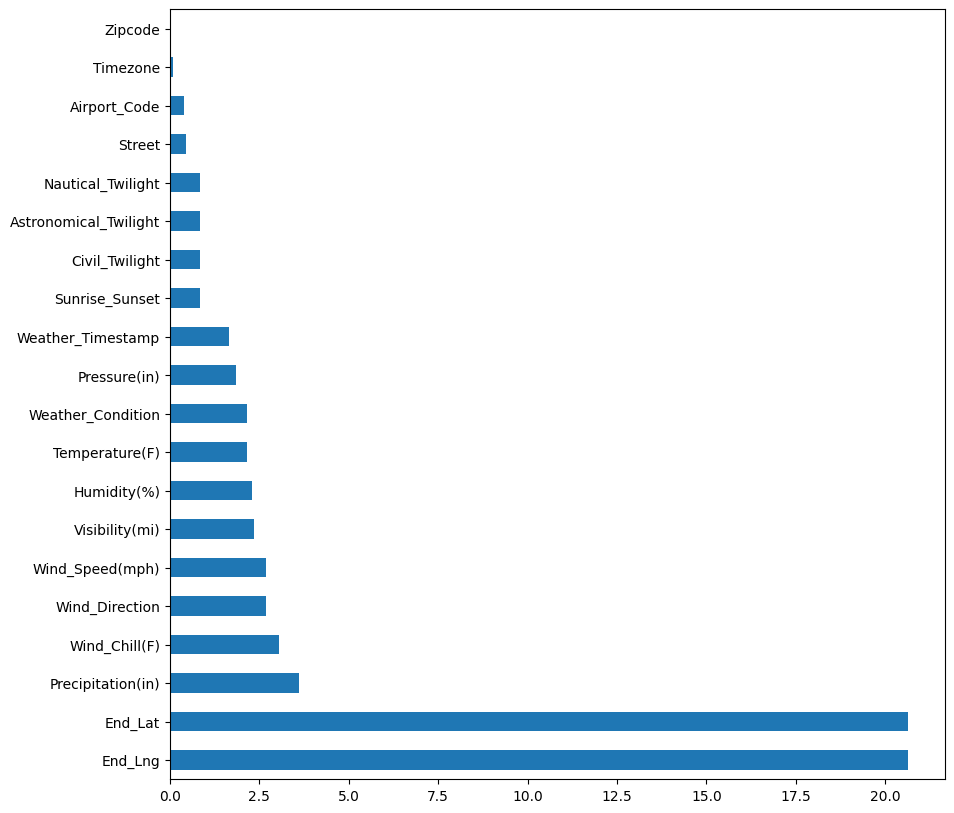

In [ ]:
missing_percentages_filtered.plot(kind="barh", figsize=(10,10))

In [ ]:
df_cleaned= df.drop('End_Lat',axis=1);
df_cleaned= df.drop('End_Lng',axis=1);
df_cleaned["City"] = (
    df_cleaned["City"]
    .str.strip()
    .str.title()
)

df_cleaned.head()

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,Distance(mi),Description,...,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-512230,Source2,1,2022-09-08 05:49:30,2022-09-08 06:34:53,41.946796,-88.208092,NaN,0.00,Crash on CR-11 Army Trail Rd at IL-59.,...,False,False,False,False,True,False,Night,Night,Day,Day
1,A-512231,Source2,1,2022-09-08 02:02:05,2022-09-08 04:31:32,34.521172,-117.958076,NaN,0.00,Crash on CA-138 Pearblossom Hwy at 96th St.,...,False,False,False,False,False,False,Night,Night,Night,Night
2,A-512232,Source2,1,2022-09-08 05:14:12,2022-09-08 07:38:17,37.542839,-77.441780,NaN,0.00,Crash on 2nd St Northbound at Franklin St.,...,False,False,False,False,True,False,Night,Night,Night,Night
3,A-512233,Source2,1,2022-09-08 06:22:57,2022-09-08 06:52:42,40.896629,-81.178452,NaN,0.00,Crash on US-62 Atlantic Blvd Westbound after O...,...,False,False,False,False,False,False,Night,Night,Day,Day
4,A-512234,Source2,2,2022-09-08 06:36:20,2022-09-08 07:05:58,41.409359,-81.644318,NaN,1.91,Crash on entry ramp to I-77 Northbound at Exit...,...,False,False,False,False,False,False,Night,Day,Day,Day


# Exploratory Analysis and Visualisation

1. City
2. Start Time
3. Start Lat, Start Lng
4. Temperature
5. Weather Condition

In [ ]:
df_cleaned.columns


Index(['ID', 'Source', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat',
       'Start_Lng', 'End_Lat', 'Distance(mi)', 'Description', 'Street', 'City',
       'County', 'State', 'Zipcode', 'Country', 'Timezone', 'Airport_Code',
       'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)', 'Humidity(%)',
       'Pressure(in)', 'Visibility(mi)', 'Wind_Direction', 'Wind_Speed(mph)',
       'Precipitation(in)', 'Weather_Condition', 'Amenity', 'Bump', 'Crossing',
       'Give_Way', 'Junction', 'No_Exit', 'Railway', 'Roundabout', 'Station',
       'Stop', 'Traffic_Calming', 'Traffic_Signal', 'Turning_Loop',
       'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

In [ ]:
cities = df_cleaned.City.unique()
len(cities)

10037

In [ ]:
cities_by_accident = (
    df_cleaned.groupby("City").size().sort_values(ascending=False)
)

cities_by_accident_significant = cities_by_accident[cities_by_accident > 1000]


In [ ]:
NY_accidents = cities_by_accident_significant.loc["New York"]
NY_accidents


np.int64(4965)

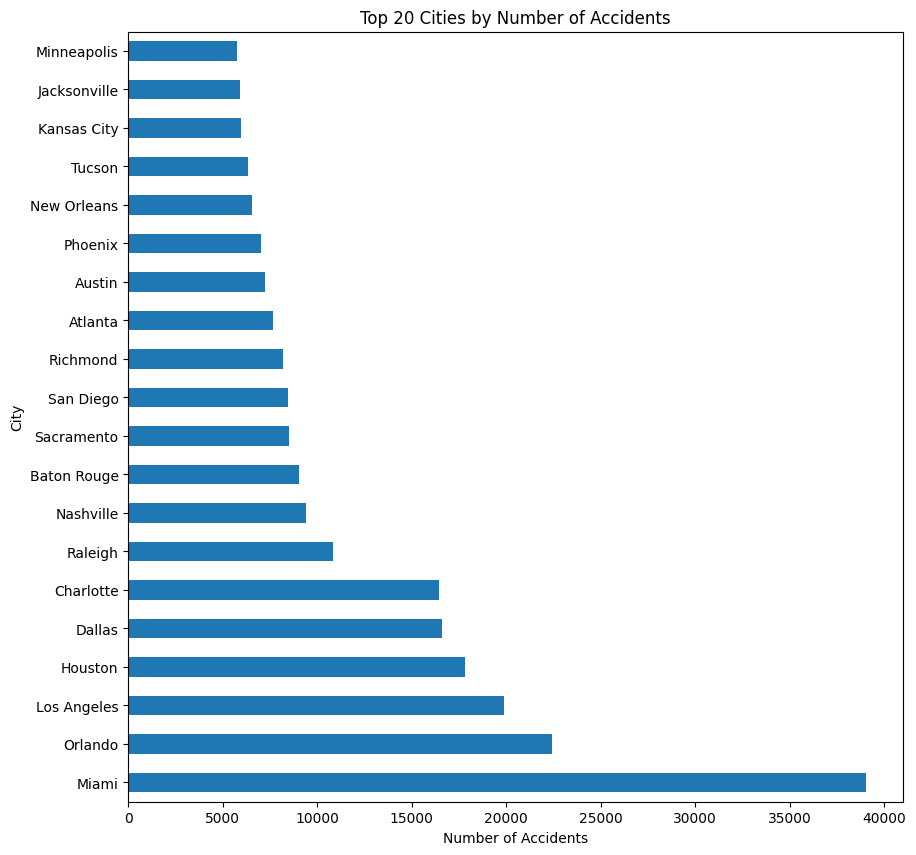

In [ ]:
# cities_by_accident_significant[:20].plot(kind="barh", figsize=(10,10))
cities_by_accident_significant[:20].plot(kind="barh",figsize=(10, 10))

plt.xlabel("Number of Accidents")
plt.ylabel("City")
plt.title("Top 20 Cities by Number of Accidents")
plt.show()


# Ask and Answer Questions

TODOS:
- talk about EDA
- talk about dataset (source, what it contains, how it will be used)
- are there more accidents in warmer or colder areas
- which states have the highest no of accidents? Per Capita?
- Why doesnt NY show up in the data? if yes why is the count so low if it is the most populated city

### Question 1:
But just finding the number of accidents doesn't make sense right considering a varying population? A more accurate figure would be accidents per capita. But our dataset doesn't have population data. Time to merge!

In [ ]:
path_to_pop= kagglehub.dataset_download("dataanalyst001/population-of-all-us-cities-2024")
pop_df = pd.read_csv(f"{path_to_pop}/Population of all US Cities 2024.csv")

100%|██████████| 8.29k/8.29k [00:00<00:00, 14.3MB/s]

Extracting files...


In [ ]:
pop_df.head()

,Rank,US City,US State,Population 2024,Population 2020,Annual Change,Density (/mile2),Area (mile2)
0,1,New York,New York,8097282,8740292,-0.0195,26950,300.46
1,2,Los Angeles,California,3795936,3895848,-0.0065,8068,470.52
2,3,Chicago,Illinois,2638159,2743329,-0.0099,11584,227.75
3,4,Houston,Texas,2319119,2299269,0.0021,3620,640.61
4,5,Phoenix,Arizona,1662607,1612459,0.0076,3208,518.33


In [ ]:
pop_df.shape[0]

300

In [ ]:
cities_by_accident_significant.name = 'AccidentCount'
merged_cities_by_accident= pd.merge(cities_by_accident_significant,pop_df,left_index=True, right_on="US City",how="inner")
merged_cities_by_accident.head()

,AccidentCount,Rank,US City,US State,Population 2024,Population 2020,Annual Change,Density (/mile2),Area (mile2)
41,39056,42,Miami,Florida,460289,442827,0.0096,12787,36.00
57,22413,58,Orlando,Florida,325044,307834,0.0134,2922,111.24
1,19856,2,Los Angeles,California,3795936,3895848,-0.0065,8068,470.52
3,17804,4,Houston,Texas,2319119,2299269,0.0021,3620,640.61
8,16616,9,Dallas,Texas,1302753,1303212,-0.0001,3835,339.68


In [ ]:
merged_cities_by_accident["AccidentsPerCapita"] = merged_cities_by_accident["AccidentCount"]/merged_cities_by_accident["Population 2024"]
merged_cities_by_accident[["US State","AccidentsPerCapita"]].sort_values("AccidentsPerCapita", ascending=False)

,US State,AccidentsPerCapita
41,Florida,0.084851
282,California,0.072084
57,Florida,0.068954
112,Louisiana,0.041552
179,Kansas,0.039450
...,...,...
6,Texas,0.002131
5,Pennsylvania,0.002112
22,Texas,0.001648
2,Illinois,0.001205


In [ ]:
merged_cities_by_accident.head()

,AccidentCount,Rank,US City,US State,Population 2024,Population 2020,Annual Change,Density (/mile2),Area (mile2),AccidentsPerCapita
41,39056,42,Miami,Florida,460289,442827,0.0096,12787,36.00,0.084851
57,22413,58,Orlando,Florida,325044,307834,0.0134,2922,111.24,0.068954
1,19856,2,Los Angeles,California,3795936,3895848,-0.0065,8068,470.52,0.005231
3,17804,4,Houston,Texas,2319119,2299269,0.0021,3620,640.61,0.007677
8,16616,9,Dallas,Texas,1302753,1303212,-0.0001,3835,339.68,0.012755


In [ ]:
merged_cities_by_accident["City_State"] = (
    merged_cities_by_accident["US City"] + ", " + merged_cities_by_accident["US State"]
)

Text(0.5, 1.0, 'Top 20 Cities by Number of Accidents Per Capita')

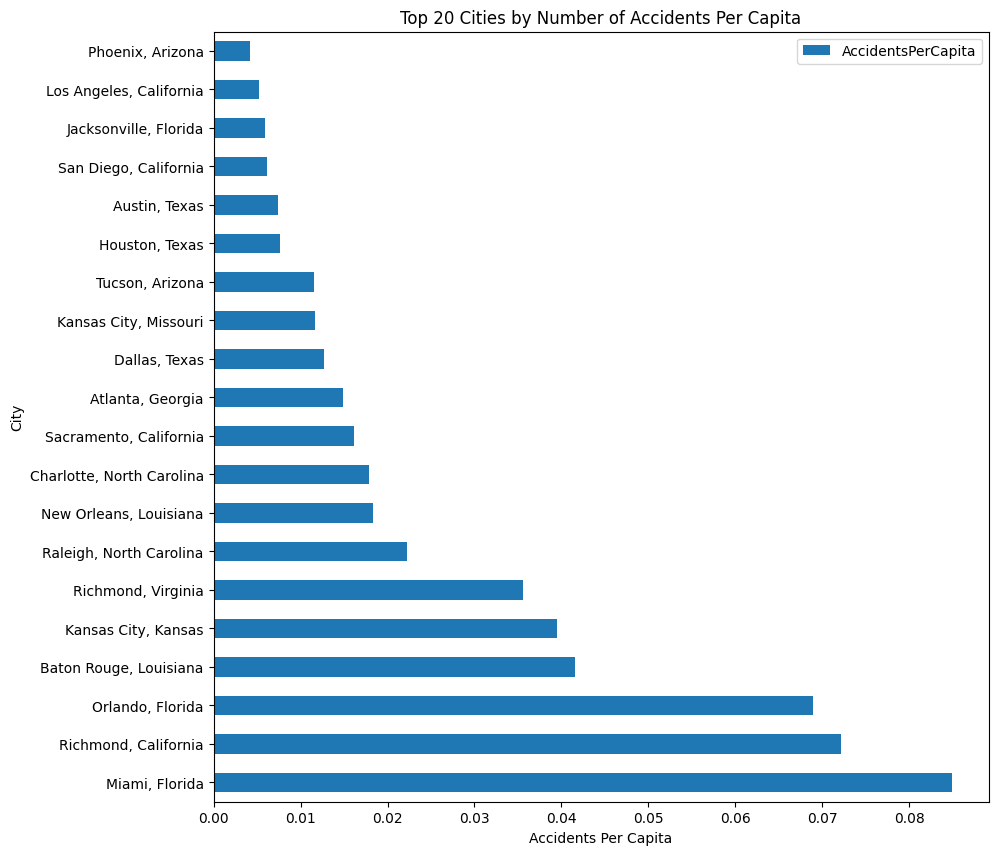

In [ ]:
merged_cities_by_accident[:20].sort_values("AccidentsPerCapita",ascending=False).plot(x="City_State", y="AccidentsPerCapita", kind="barh", figsize=(10,10))
plt.xlabel("Accidents Per Capita")
plt.ylabel("City")
plt.title("Top 20 Cities by Number of Accidents Per Capita")

Things have quite flipped haven't they? Per capita was surely a better measure

### Question 2:

Out of the top 100 cities in the number of accidents, which states do they belong to?

In [ ]:
cities_and_states=df[["City","State"]].drop_duplicates()
cities_and_states

,City,State
0,Bartlett,IL
1,Littlerock,CA
2,Richmond,VA
3,Alliance,OH
4,Independence,OH
...,...,...
1139207,Glenrock,WY
1139302,Kresgeville,PA
1139813,Vandalia,MI
1142087,Verona,NJ


In [ ]:
city_to_state = dict(zip(cities_and_states["City"],
                         cities_and_states["State"]))

In [ ]:
cities_by_accident_significant = cities_by_accident_significant.to_frame(name='Accidents')
cities_by_accident_significant["State"] = cities_by_accident_significant.index.map(city_to_state)
cities_by_accident_significant.head()

,Accidents,State
City,,
Miami,39056,AZ
Orlando,22413,WV
Los Angeles,19856,CA
Houston,17804,AL
Dallas,16616,GA


In [ ]:
accidents_by_state = cities_by_accident_significant[:100].groupby("State").sum().sort_values("Accidents",ascending=False)
accidents_by_state.head()

,Accidents
State,
CA,60472
AZ,45375
FL,40912
WV,26909
MI,26118


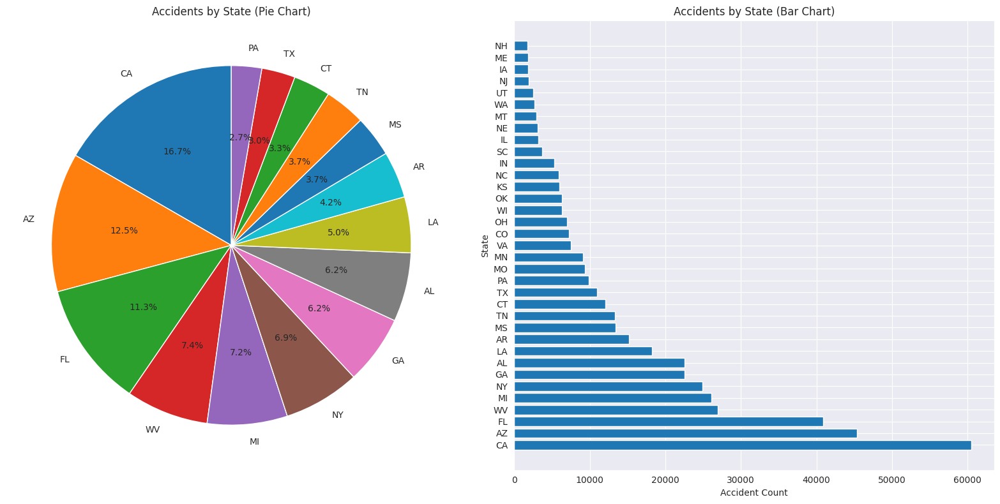

In [ ]:
import matplotlib.pyplot as plt
sns.set_style('darkgrid')
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

# ---------------- Pie Chart ----------------
axes[0].pie(
    accidents_by_state['Accidents'][:15],
    labels=accidents_by_state.index[:15],
    autopct='%1.1f%%',
    startangle=90
)
axes[0].set_title("Accidents by State (Pie Chart)")

# ---------------- Bar Chart ----------------
axes[1].barh(accidents_by_state.index, accidents_by_state.Accidents)
axes[1].set_title("Accidents by State (Bar Chart)")
axes[1].set_xlabel("Accident Count")
axes[1].set_ylabel("State")

plt.tight_layout()
plt.show()


Among the top 100 cities in number of accidents, Mississipi is on top followed by California and New York

### Question 3:
Do most cities have moderate accident rate or do some cities have very high rates?

In [ ]:
cities_by_accident_significant["Accidents"] = pd.to_numeric(
    cities_by_accident_significant["Accidents"],
    errors="coerce"
)


In [ ]:
merged_cities_by_accident.head()

,AccidentCount,Rank,US City,US State,Population 2024,Population 2020,Annual Change,Density (/mile2),Area (mile2),AccidentsPerCapita,City_State
41,39056,42,Miami,Florida,460289,442827,0.0096,12787,36.00,0.084851,"Miami, Florida"
57,22413,58,Orlando,Florida,325044,307834,0.0134,2922,111.24,0.068954,"Orlando, Florida"
1,19856,2,Los Angeles,California,3795936,3895848,-0.0065,8068,470.52,0.005231,"Los Angeles, California"
3,17804,4,Houston,Texas,2319119,2299269,0.0021,3620,640.61,0.007677,"Houston, Texas"
8,16616,9,Dallas,Texas,1302753,1303212,-0.0001,3835,339.68,0.012755,"Dallas, Texas"


In [ ]:
high_accident_cities_pc=merged_cities_by_accident[merged_cities_by_accident["AccidentsPerCapita"] > 0.01]
len(high_accident_cities_pc)/len(merged_cities_by_accident)

0.39823008849557523

This shows that only about 1.4% of the total cities have a high per capita of accidents

In [ ]:
high_accident_cities = merged_cities_by_accident[merged_cities_by_accident["AccidentCount"] > 5000]
len(high_accident_cities)/len(merged_cities_by_accident)

0.21238938053097345

Only 1.6% cities have more than 1000 accidents recorded

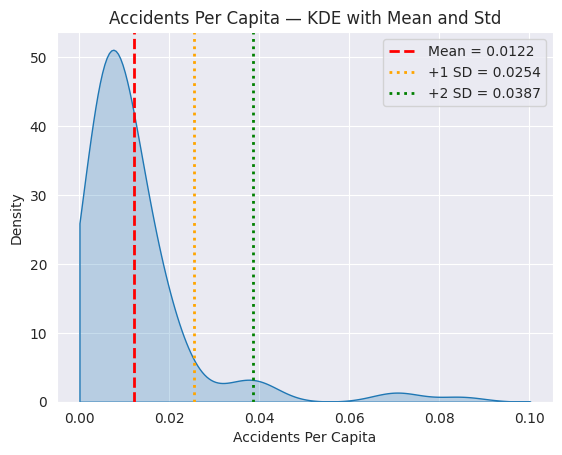

<Figure size 3000x1000 with 0 Axes>

In [ ]:
x = merged_cities_by_accident["AccidentsPerCapita"].dropna()

# Compute statistics
mean = x.mean()
std = x.std()


# Plot KDE
ax = sns.kdeplot(
    x=x,
    fill=True,
    clip=(0,None),
    bw_adjust=1.0
)

# Plot mean
ax.axvline(mean, color="red", linestyle="--", linewidth=2, label=f"Mean = {mean:.4f}")

# Plot std boundaries
# ax.axvline(mean - std, color="orange", linestyle=":", linewidth=2, label=f"-1 SD = {mean - std:.4f}")
ax.axvline(mean + std, color="orange", linestyle=":", linewidth=2, label=f"+1 SD = {mean + std:.4f}")

# Plot std boundaries
# ax.axvline(mean - 2*std, color="green", linestyle=":", linewidth=2, label=f"-2 SD = {mean - 2*std:.4f}")
ax.axvline(mean + 2*std, color="green", linestyle=":", linewidth=2, label=f"+2 SD = {mean + 2*std:.4f}")

# Add legend and titles
ax.legend()
ax.set_title("Accidents Per Capita — KDE with Mean and Std")
ax.set_xlabel("Accidents Per Capita")
plt.figure(figsize=(30, 10))   # wider plot

plt.show()

Most accidents(68% of the data) lie in the range 0-0.0658 per capita
95% of the data lies in the 0-0.1 per capita range



### Question 4:
Do more accidents occur in the warmer temperatures or cooler temperature?

In [ ]:
df_cleaned.columns

Index(['ID', 'Source', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat',
       'Start_Lng', 'End_Lat', 'Distance(mi)', 'Description', 'Street', 'City',
       'County', 'State', 'Zipcode', 'Country', 'Timezone', 'Airport_Code',
       'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)', 'Humidity(%)',
       'Pressure(in)', 'Visibility(mi)', 'Wind_Direction', 'Wind_Speed(mph)',
       'Precipitation(in)', 'Weather_Condition', 'Amenity', 'Bump', 'Crossing',
       'Give_Way', 'Junction', 'No_Exit', 'Railway', 'Roundabout', 'Station',
       'Stop', 'Traffic_Calming', 'Traffic_Signal', 'Turning_Loop',
       'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

In [ ]:
df_cleaned['Temperature(F)'].notna().sum() #reasonably large

np.int64(1119772)

In [ ]:
low_temp_accidents = df_cleaned[df_cleaned["Temperature(F)"] <40]
percentage = (len(low_temp_accidents) / len(df_cleaned)) * 100
print(percentage)


13.58694132613832


In [ ]:
low_temp_accidents = df_cleaned[(df_cleaned["Temperature(F)"] >= 60) &
                                (df_cleaned["Temperature(F)"] <= 80)]

percentage = (len(low_temp_accidents) / len(df_cleaned)) * 100
print(percentage)


41.822339265493284


In [ ]:
low_temp_accidents = df_cleaned[df_cleaned["Temperature(F)"] >80]
percentage = (len(low_temp_accidents) / len(df_cleaned)) * 100
print(percentage)


19.294431784820567


In [ ]:
bins = [-100, 40, 50, 60, 70, 80, 90, 200]   # covers all possible temps
labels = ["<40°F", "40–50°F", "50–60°F", "60–70°F", "70–80°F", "80–90°F", ">90°F"]

df_cleaned["Temp_Bin"] = pd.cut(df_cleaned["Temperature(F)"], bins=bins, labels=labels)


In [ ]:
accidents_by_bin = df_cleaned["Temp_Bin"].value_counts().sort_index()


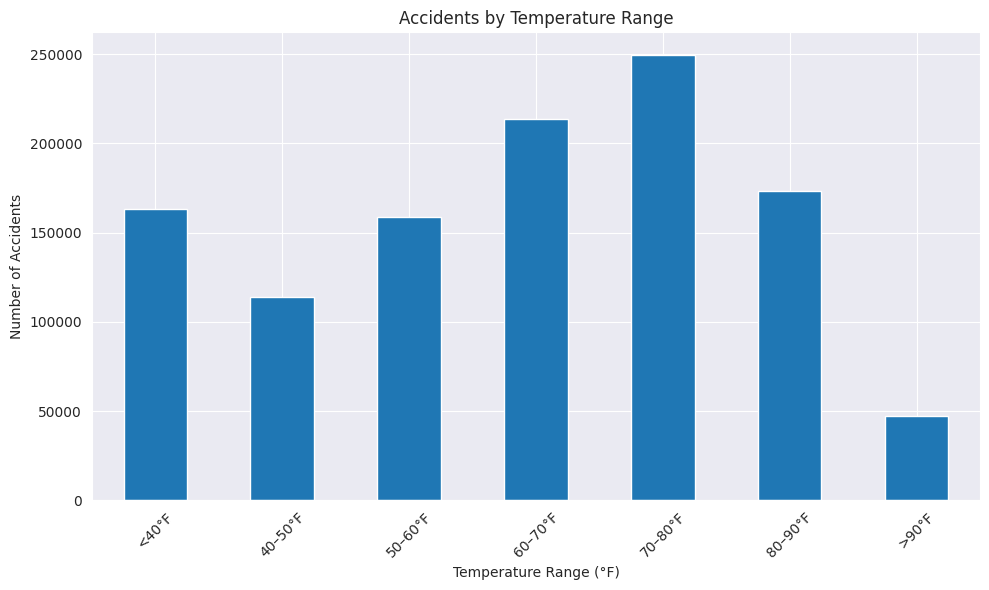

In [ ]:
plt.figure(figsize=(10, 6))
accidents_by_bin.plot(kind='bar')
plt.xlabel("Temperature Range (°F)")
plt.ylabel("Number of Accidents")
plt.title("Accidents by Temperature Range")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


### Question 5:
Do more severe accidents happen during the day or during the night?

In [ ]:
df.describe()

,Severity,Start_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
count,1.144496e+06,1144496,1.144496e+06,1.144496e+06,908314.000000,908314.000000,1.144496e+06,1.119772e+06,1.109746e+06,1.118177e+06,1.123404e+06,1.117746e+06,1.113694e+06,1.103069e+06
mean,2.080871e+00,2022-06-22 19:23:22.970895872,3.594595e+01,-9.296254e+01,35.948908,-93.347359,8.724057e-01,6.310693e+01,6.181349e+01,6.230760e+01,2.937063e+01,9.161273e+00,7.637690e+00,5.623719e-03
min,1.000000e+00,2022-01-01 00:02:00,2.455480e+01,-1.245410e+02,24.569978,-124.544508,0.000000e+00,-4.500000e+01,-6.300000e+01,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,2.000000e+00,2022-03-21 15:46:25.500000,3.301775e+01,-1.120938e+02,32.992702,-117.063629,3.100000e-02,5.100000e+01,5.100000e+01,4.500000e+01,2.920000e+01,1.000000e+01,3.000000e+00,0.000000e+00
50%,2.000000e+00,2022-06-15 05:43:10,3.585608e+01,-8.452914e+01,36.060766,-84.411701,2.100000e-01,6.700000e+01,6.700000e+01,6.400000e+01,2.971000e+01,1.000000e+01,7.000000e+00,0.000000e+00
75%,2.000000e+00,2022-09-14 17:27:00,3.998109e+01,-8.012325e+01,40.006551,-79.881834,9.140000e-01,7.800000e+01,7.800000e+01,8.200000e+01,2.996000e+01,1.000000e+01,1.000000e+01,0.000000e+00
max,4.000000e+00,2022-12-31 23:59:03,4.900050e+01,-6.828378e+01,49.002223,-69.088179,3.365700e+02,1.720000e+02,1.720000e+02,1.000000e+02,5.863000e+01,1.000000e+02,1.900000e+02,3.647000e+01
std,4.317013e-01,NaN,5.133035e+00,1.719220e+01,5.241197,17.556449,2.052364e+00,1.985108e+01,2.221931e+01,2.302094e+01,1.122233e+00,2.383530e+00,5.535853e+00,5.650975e-02


In [ ]:
df['Sunrise_Sunset'].notna().sum()

np.int64(1134874)

In [ ]:
accidents_by_severity = df_cleaned.groupby(['Severity', 'Sunrise_Sunset']).size()
accidents_by_severity #difficult to read


Severity  Sunrise_Sunset
1         Day                30571
          Night               7103
2         Day               713516
          Night             280936
3         Day                58831
          Night              18460
4         Day                15465
          Night               9992
dtype: int64

In [ ]:
df_plot = accidents_by_severity.reset_index()
df_plot.columns = ['Severity', 'Sunrise_Sunset', 'Count']
df_plot

,Severity,Sunrise_Sunset,Count
0,1,Day,30571
1,1,Night,7103
2,2,Day,713516
3,2,Night,280936
4,3,Day,58831
5,3,Night,18460
6,4,Day,15465
7,4,Night,9992


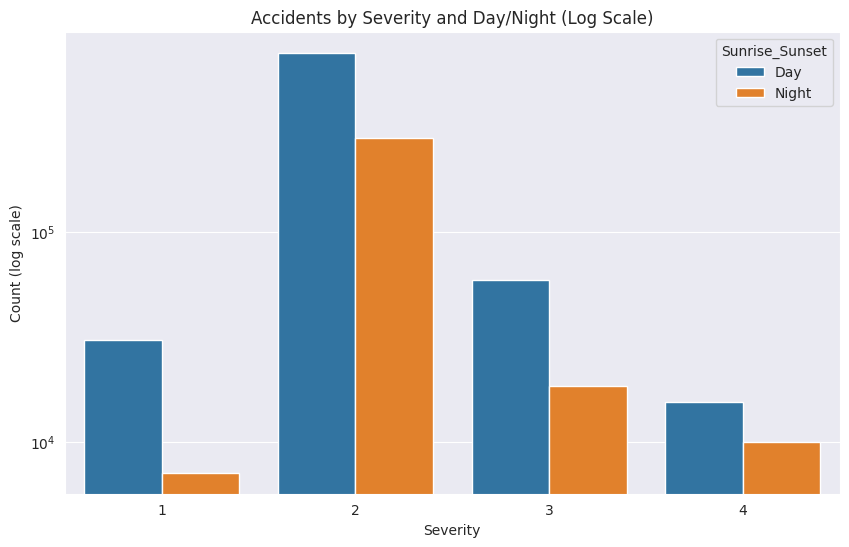

In [ ]:

plt.figure(figsize=(10,6))
sns.barplot(
    data=df_plot,
    x="Severity",
    y="Count",
    hue="Sunrise_Sunset"
)

plt.yscale("log")
plt.title("Accidents by Severity and Day/Night (Log Scale)")
plt.ylabel("Count (log scale)")
plt.show()

### Question 6:
Is low visibility associated with higher severity?

In [ ]:
df_cleaned.groupby("Severity")["Visibility(mi)"].describe()


,count,mean,std,min,25%,50%,75%,max
Severity,,,,,,,,
1,37308.0,9.446931,1.775114,0.0,10.0,10.0,10.0,60.0
2,979128.0,9.150508,2.405282,0.0,10.0,10.0,10.0,100.0
3,76382.0,9.184930,2.327029,0.0,10.0,10.0,10.0,75.0
4,24928.0,9.084107,2.461363,0.0,10.0,10.0,10.0,40.0


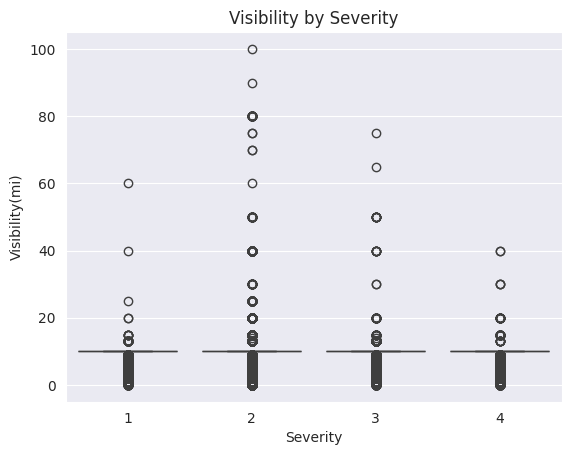

In [ ]:
sns.boxplot(
    data=df_cleaned,
    x="Severity",
    y="Visibility(mi)"
)
plt.title("Visibility by Severity")
plt.show()


### Question 7:
Does presence of traffic signals reduce or increase accidents?

In [ ]:
df.columns

Index(['ID', 'Source', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat',
       'Start_Lng', 'End_Lat', 'End_Lng', 'Distance(mi)', 'Description',
       'Street', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

In [ ]:
accidents_by_traffic = df_cleaned.groupby("Traffic_Signal").size()
accidents_by_traffic

,0
Traffic_Signal,
False,1033417
True,111079


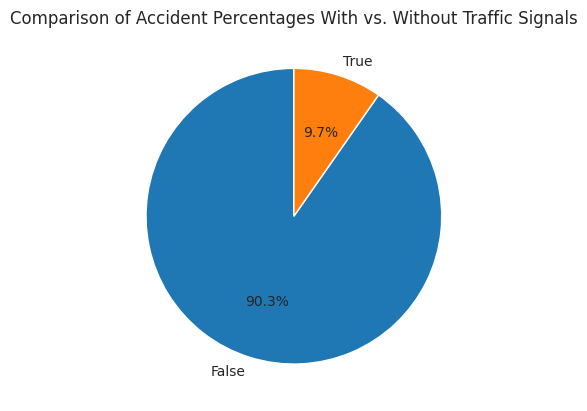

In [ ]:
plt.pie(
    accidents_by_traffic,
    labels=accidents_by_traffic.index,
    autopct='%1.1f%%',
    startangle=90
)

plt.title("Comparison of Accident Percentages With vs. Without Traffic Signals")
plt.show()

### Question 8:
Which infrastructure features correlate most with accident severity?

In [ ]:
df.columns


Index(['ID', 'Source', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat',
       'Start_Lng', 'End_Lat', 'End_Lng', 'Distance(mi)', 'Description',
       'Street', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

In [ ]:
df_cleaned["Turning_Loop"].dtype

dtype('bool')

In [ ]:
cols = [
    'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
    'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Turning_Loop'
]

accidents_by_infra = df_cleaned[cols].sum().to_frame(name="True_Count")
accidents_by_infra

,True_Count
Bump,642
Crossing,107357
Give_Way,4316
Junction,73009
No_Exit,2851
Railway,8580
Roundabout,27
Station,29450
Stop,30291
Traffic_Calming,1254


<Axes: >

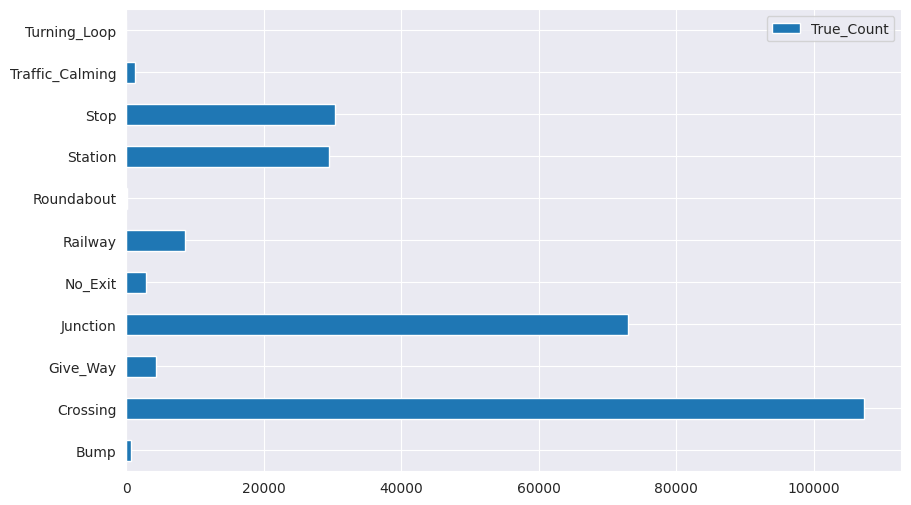

In [ ]:
accidents_by_infra.plot(kind="barh", figsize=(10,6))

### Question 9:
What can we get out of the description?

In [ ]:
!pip install wordcloud


In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt


In [ ]:
text = " ".join(df_cleaned["Description"].astype(str).tolist())

In [ ]:
wordcloud = WordCloud(
    width=1600,
    height=800,
    background_color='white',
    stopwords=STOPWORDS,
    collocations=False  # avoids repeated phrases like "accident accident"
).generate(text)


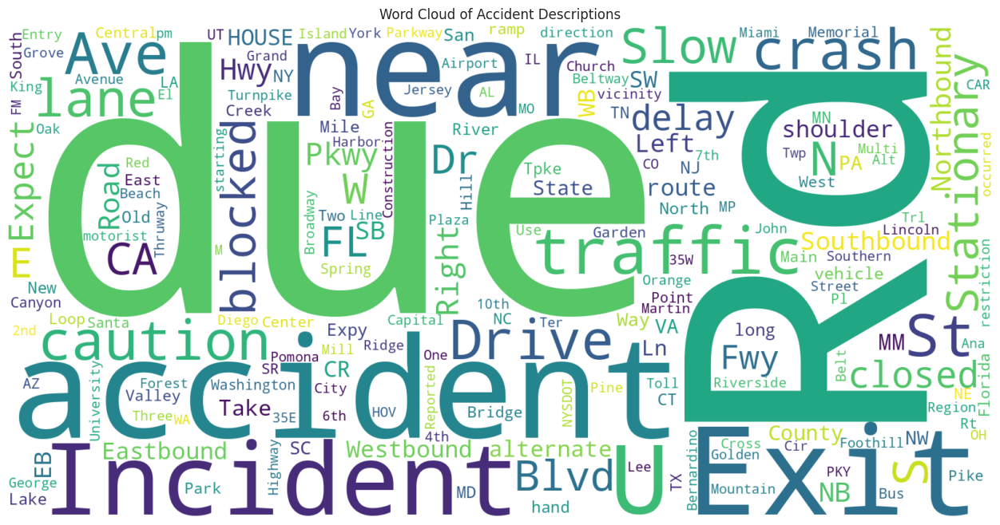

In [ ]:
plt.figure(figsize=(16, 8))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.title("Word Cloud of Accident Descriptions")
plt.show()

### Question 10:
What is the number of accidents month-wise?

In [ ]:
accidents_by_month = df_cleaned.groupby(df_cleaned["Start_Time"].dt.month).size()
accidents_by_month

,0
Start_Time,
1,93108
2,111529
3,94965
4,129924
5,105036
6,87196
7,94628
8,101791
9,85718


<Axes: xlabel='Start_Time'>

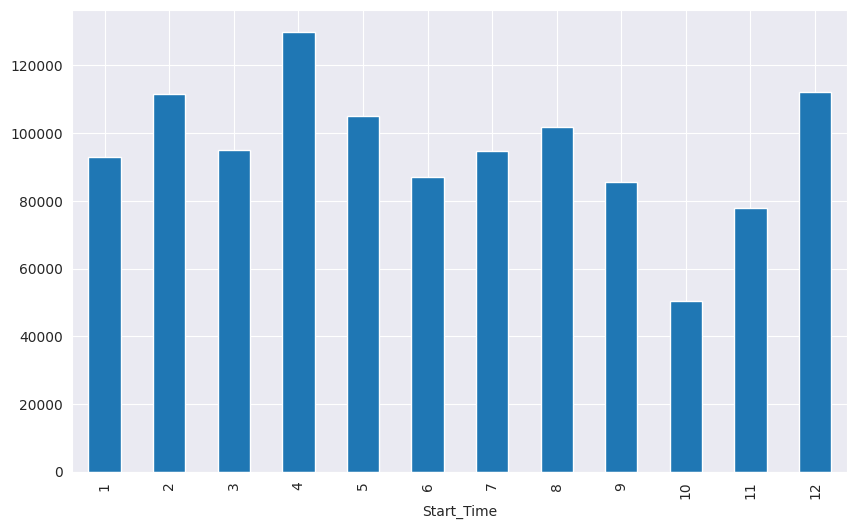

In [ ]:
accidents_by_month.plot(kind="bar", figsize=(10,6))

### Question 11:
Are there more accidents on weekdays or weekends?

In [ ]:
accidents_by_day= df_cleaned.groupby(df_cleaned["Start_Time"].dt.day_name()).size()
accidents_by_day

,0
Start_Time,
Friday,199719
Monday,163502
Saturday,123448
Sunday,96611
Thursday,191587
Tuesday,180580
Wednesday,189049


<Axes: ylabel='Start_Time'>

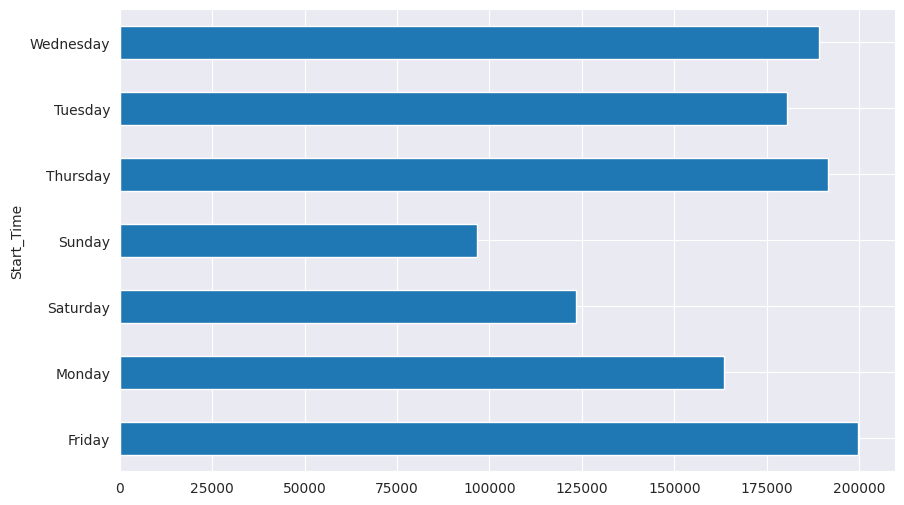

In [ ]:
accidents_by_day.plot(kind="barh",figsize=(10,6))

In [ ]:
accidents_by_time = df_cleaned.groupby(df_cleaned["Start_Time"].dt.hour).size()
accidents_by_time

,0
Start_Time,
0,15577
1,12441
2,12707
3,11570
4,20426
5,30908
6,57606
7,83770
8,76430


<Axes: xlabel='Start_Time'>

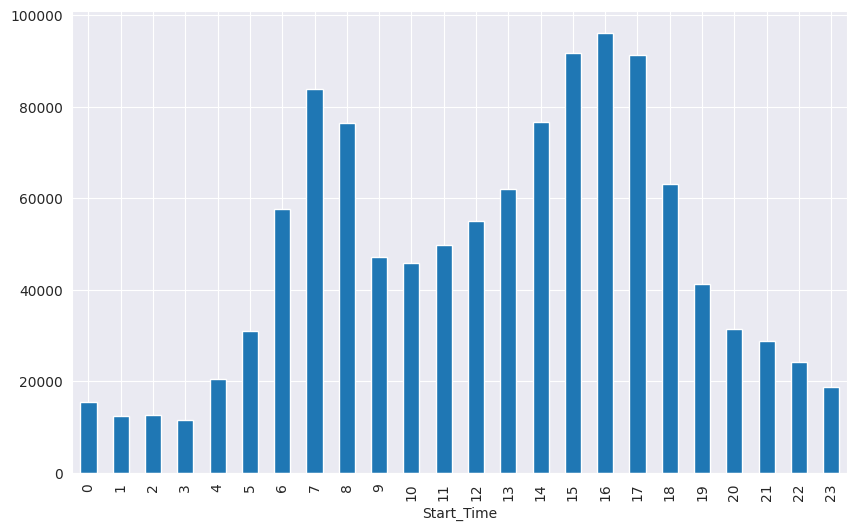

In [ ]:
accidents_by_time.plot(kind="bar",figsize=(10,6))

### Question 12:
Studying the geography of the accident locations

In [ ]:
!pip install folium


In [ ]:
import folium
from folium.plugins import HeatMap

# Center on US
m = folium.Map(location=[39.5, -98.35], zoom_start=5)

# Add accident points
for _, row in df[['Start_Lat', 'Start_Lng']].sample(50000).iterrows():
    folium.CircleMarker(
        location=[row['Start_Lat'], row['Start_Lng']],
        radius=1,
        color='red',
        fill=True,
        fill_opacity=0.5
    ).add_to(m)

m


### Question 14:
Variation of Data hourwise

In [ ]:
accidents_by_hour = df_cleaned.groupby(df_cleaned["Start_Time"].dt.hour).size()
accidents_by_hour

,0
Start_Time,
0,15577
1,12441
2,12707
3,11570
4,20426
5,30908
6,57606
7,83770
8,76430


<Axes: xlabel='Start_Time'>

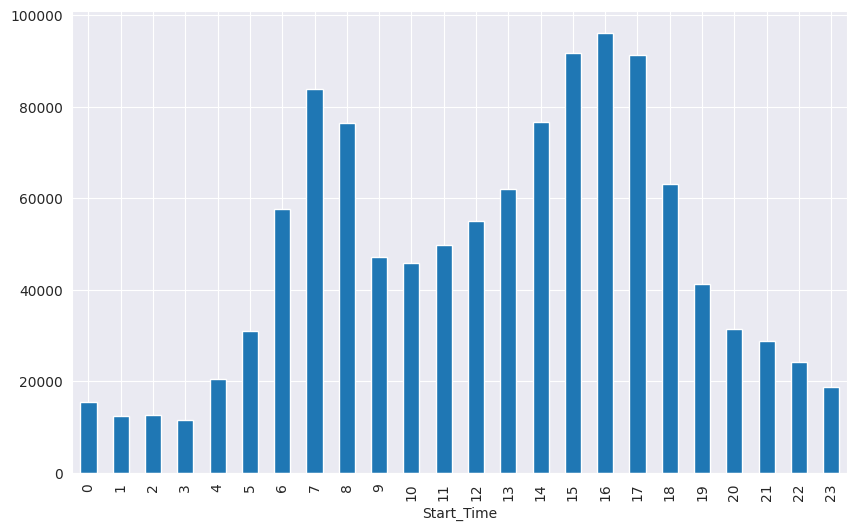

In [ ]:
accidents_by_hour.plot(kind="bar",figsize=(10,6))

# Insights
- <2% of the cities have >1000 accidents/year
- Among the 100 top cities in number of accidents, ~12% of them fall in Mississipi, ~11% in California and ~9% in New York States.
- 35.8% accidents happen at warmer temperatures (>90 F) rest in lower temperatures
- On a Scale of 1-4 on severity, 2 and 3 are most common ones. But across severities, significantly more accidents happen during the day than at night. Also the night to day ratio increases with severity.
- Maximum Accidents occur in normal visibilities. There is no correlation between visibility and accidents
- Presence of Traffic Signals significantly reduces the accident count
- A large share of accidents are caused near crossings followed by junctions and stops. Others are comparatively insignificant